# Python for Data Science

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AI-Core/Python-for-Data-Science/blob/main/Notebook.ipynb)


## The Problem

__Loan default prediction__ is one of the most critical and crucial problems faced by financial institutions and organizations as it has a noteworthy effect on the profitability of these institutions. In recent years, there is a tremendous increase in the volume of _non–performing_ loans which results in a jeopardizing effect on the growth of these institutions. 

Therefore, to maintain a healthy portfolio, banks put stringent monitoring and evaluation measures in place to ensure the timely repayment of loans by borrowers. Despite these measures, a major proportion of loans become delinquent. _Delinquency_ occurs when a borrower misses a payment against his/her loan.

Given the information like mortgage details, borrowers-related details, and payment details, your objective is to build a system that can predict the defaulter status of loans for the next month given the defaulter status for the previous 12 months (in the number of months).

# Part 1 - Loading and Exploring The Dataset

## Prerequisites

1. [Comments](https://www.youtube.com/watch?v=kKTh1xCiH6Q&feature=emb_imp_woyt)
1. [Printing](https://www.youtube.com/watch?v=dbEBN7r8f-Y&feature=emb_imp_woyt)
1. [Variables](https://www.youtube.com/watch?v=VTcVnkgt-OE&feature=emb_imp_woyt)
1. [Numbers](https://www.youtube.com/watch?v=zv5Nvx29_5Q&feature=emb_imp_woyt)
1. [Lists](https://www.youtube.com/watch?v=8KwNODUQQcI&feature=emb_imp_woyt)
1. [Functions and function calls](https://www.youtube.com/watch?v=Z4Ksu4oYVRo&feature=emb_imp_woyt)
1. [OOP](https://www.youtube.com/watch?v=SG2d0w2bRVY&feature=emb_imp_woyt)
1. [Imports](https://www.youtube.com/watch?v=A18-toakFcM&feature=emb_imp_woyt)
1. [Pandas dataframes](https://www.youtube.com/watch?v=QQEYXHg1DtI&feature=emb_imp_woyt)

## The Dataset

Our dataset consists of the variables described in the table below. 

The last variable, `m13` represents whether the borrower failed to make their payments for the month following the previous 12. This is the value that we want to anticipate. 
This variable can be used to evaluate the performance of the system we create, by comparing it with the system's predictions.

| Variable                   | Description                                                      |
| -------------------------- | ---------------------------------------------------------------- |
| loan\_id                   | Unique loan ID                                                   |
| source                     | Original Channel of Loan                                         |
| financial\_institution     | Name of the bank                                                 |
| interest\_rate             | Loan interest rate                                               |
| unpaid\_principal\_bal     | Loan unpaid principal balance                                    |
| loan\_term                 | Loan term (in days)                                              |
| origination\_date          | Loan origination date (YYYY-MM-DD)                               |
| first\_payment\_date       | First instalment payment date                                    |
| loan\_to\_value            | Loan to value ratio                                              |
| number\_of\_borrowers      | Number of borrowers                                              |
| debt\_to\_income\_ratio    | Debt-to-income ratio                                             |
| borrower\_credit\_score    | Borrower credit score                                            |
| loan\_purpose              | Loan purpose                                                     |
| insurance\_percent         | Loan Amount percent covered by insurance                         |
| co-borrower\_credit\_score | Co-borrower credit score                                         |
| insurance\_type            | 0 - Premium paid by the borrower, 1 - Premium paid by Lender     |
| m1 to m12                  | Month-wise loan performance (defaulter in months)                |
| m13                        | target, loan defaulter status (0 = Non-Defaulter, 1 = Defaulted) |


## Configuration

Run the cell below to configure some useful settings.

In [2]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', 500)

### Loading in the data

In the following cell is the link to the dataset, which is stored in the cloud, using a service called AWS S3.


In [3]:
link_to_file = "https://aicore-project-files.s3.eu-west-1.amazonaws.com/Python_for_DS/loans.csv"

This can be used to load in the dataset.

In [4]:
# loading the csv
df = pd.read_csv(link_to_file)


Generally, the first thing that you should do is have a look at a sample of your data to understand what it looks like. 
Especially ensure that you understand the format of the __target column__, `m13`. 

Let's take a look at the dataset. we can use the `.head()` function or `.tail()` function to have peek into the first 5 or last 5 rows respectively using this. 

In [5]:
df.head()

,loan_id,source,financial_institution,interest_rate,unpaid_principal_bal,loan_term,origination_date,first_payment_date,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,loan_purpose,insurance_percent,co-borrower_credit_score,insurance_type,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13
0,268055008619,Z,"Turner, Baldwin and Rhodes",4.250,214000,360,2012-03-01,05/2012,95,1.0,22.0,694.0,C86,30.0,NaN,0.0,0,0,0,0,0,0,1,0,0,0,0,0,defaulter
1,672831657627,Y,"Swanson, Newton and Miller",4.875,144000,360,2012-01-01,03/2012,72,1.0,44.0,697.0,B12,0.0,NaN,NaN,0,0,0,0,0,0,0,0,0,0,1,0,defaulter
2,742515242108,Z,Thornton-Davis,3.250,366000,180,2012-01-01,03/2012,49,1.0,33.0,780.0,B12,0.0,NaN,0.0,0,0,0,0,0,0,0,0,0,0,0,0,defaulter
3,601385667462,X,OTHER,4.750,135000,360,2012-02-01,04/2012,46,2.0,44.0,633.0,B12,0.0,638.0,0.0,0,0,0,0,0,0,0,0,1,1,1,1,defaulter
4,273870029961,X,OTHER,4.750,124000,360,2012-02-01,04/2012,80,1.0,43.0,681.0,C86,0.0,NaN,NaN,0,1,2,3,4,5,6,7,8,9,10,11,defaulter


By default, pandas assign a default index to the DataFrame. If you notice, in the given dataset `load_id` is just a column with a unique row_identifier. Let's set `loan_id` as the index. using `.set_index()` function of pandas DataFrame.

In [6]:
df.set_index(keys=['loan_id']) # setting load_id as index

,source,financial_institution,interest_rate,unpaid_principal_bal,loan_term,origination_date,first_payment_date,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,loan_purpose,insurance_percent,co-borrower_credit_score,insurance_type,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13
loan_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,
268055008619,Z,"Turner, Baldwin and Rhodes",4.250,214000,360,2012-03-01,05/2012,95,1.0,22.0,694.0,C86,30.0,NaN,0.0,0,0,0,0,0,0,1,0,0,0,0,0,defaulter
672831657627,Y,"Swanson, Newton and Miller",4.875,144000,360,2012-01-01,03/2012,72,1.0,44.0,697.0,B12,0.0,NaN,NaN,0,0,0,0,0,0,0,0,0,0,1,0,defaulter
742515242108,Z,Thornton-Davis,3.250,366000,180,2012-01-01,03/2012,49,1.0,33.0,780.0,B12,0.0,NaN,0.0,0,0,0,0,0,0,0,0,0,0,0,0,defaulter
601385667462,X,OTHER,4.750,135000,360,2012-02-01,04/2012,46,2.0,44.0,633.0,B12,0.0,638.0,0.0,0,0,0,0,0,0,0,0,1,1,1,1,defaulter
273870029961,X,OTHER,4.750,124000,360,2012-02-01,04/2012,80,1.0,43.0,681.0,C86,0.0,NaN,NaN,0,1,2,3,4,5,6,7,8,9,10,11,defaulter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
382119962287,Y,Browning-Hart,4.125,153000,360,2012-02-01,04/2012,88,2.0,22.0,801.0,A23,25.0,802.0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
582803915466,Z,OTHER,3.000,150000,120,2012-01-01,03/2012,35,1.0,37.0,796.0,B12,0.0,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
837922316947,X,OTHER,3.875,166000,360,2012-02-01,04/2012,58,2.0,49.0,724.0,B12,0.0,723.0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter


In [7]:
# another way of setting loan_id as index
df = pd.read_csv(link_to_file, index_col=0)

So now we have loaded the data with the correct index columns. It's time to dig a little deeper into the data. We will use : 
1. `.describe()` : To display the min, max, mean, median, 0.25 and 0.75 quantiles of every numerical column. 
2. `.info()` : This function displays information such as the `dtype` of each column, the count of non-null values in each columns, and the amount of memory occupied by the dataset, among other details.

Try them below:

In [8]:
# describe
df.describe().T

,count,mean,std,min,25%,50%,75%,max
interest_rate,116058.0,3.868961,0.461020,2.25,3.5,3.875,4.125,6.75
unpaid_principal_bal,116058.0,208226.223095,114685.099114,11000.00,120000.0,183000.000,278000.000,1200000.00
loan_term,116058.0,292.280997,89.762415,60.00,180.0,360.000,360.000,360.00
loan_to_value,116058.0,67.431939,17.291719,6.00,57.0,72.000,80.000,97.00
number_of_borrowers,116058.0,1.593186,0.491242,1.00,1.0,2.000,2.000,2.00
debt_to_income_ratio,116058.0,30.742293,9.730798,1.00,23.0,31.000,39.000,64.00
borrower_credit_score,116007.0,770.265260,39.010306,480.00,751.0,782.000,800.000,840.00
insurance_percent,116058.0,2.786288,8.096464,0.00,0.0,0.000,0.000,40.00
co-borrower_credit_score,68795.0,775.370289,35.708863,620.00,759.0,786.000,801.000,836.00
insurance_type,63628.0,0.003253,0.056945,0.00,0.0,0.000,0.000,1.00


In [9]:
# info
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 116058 entries, 268055008619 to 763308490661
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   source                    116058 non-null  object 
 1   financial_institution     116058 non-null  object 
 2   interest_rate             116058 non-null  float64
 3   unpaid_principal_bal      116058 non-null  int64  
 4   loan_term                 116058 non-null  int64  
 5   origination_date          116058 non-null  object 
 6   first_payment_date        116058 non-null  object 
 7   loan_to_value             116058 non-null  int64  
 8   number_of_borrowers       116058 non-null  float64
 9   debt_to_income_ratio      116058 non-null  float64
 10  borrower_credit_score     116007 non-null  float64
 11  loan_purpose              116058 non-null  object 
 12  insurance_percent         116058 non-null  float64
 13  co-borrower_credit_score  6

### Missing Value Analysis

The next step is to do missing value analysis.
Missing values in pandas DataFrames are defined by a `Nan` (Not a number). 
You will see a `Nan` whenever there is absence of a value. 

It is very important to handle these missing values for a number of reasons:
1. Better Predictive Modelling: Most machine learning algorithms can't predict with missing values.
2. Better Data Quality: Many times missing values can be filled by doing intelligent analysis of data. This leads to improvement in data quality.

Here are some rough guidelines for how to handle missing values
If more than 30% of a column has missing values, drop that column.
Otherwise, there are two things that you can do:
1. Impute the missing values (fill them in)
2. Drop the rows containing null values

_Note: dropping null rows should not add any target data imbalance in the dataset._

In [10]:
df.isna().mean()*100

source                       0.000000
financial_institution        0.000000
interest_rate                0.000000
unpaid_principal_bal         0.000000
loan_term                    0.000000
origination_date             0.000000
first_payment_date           0.000000
loan_to_value                0.000000
number_of_borrowers          0.000000
debt_to_income_ratio         0.000000
borrower_credit_score        0.043944
loan_purpose                 0.000000
insurance_percent            0.000000
co-borrower_credit_score    40.723604
insurance_type              45.175688
m1                           0.000000
m2                           0.000000
m3                           0.000000
m4                           0.000000
m5                           0.000000
m6                           0.000000
m7                           0.000000
m8                           0.000000
m9                           0.000000
m10                          0.000000
m11                          0.000000
m12         

We can clearly see there are 3 columns with null values
- `co-borrower_credit_score` > 30 %
- `insurance_type` > 30 %
- `insurance_type` < 30 %

In [11]:
# We will go forward and drop the columns with more than 30% missing values
df.drop(labels=["co-borrower_credit_score", "insurance_type"], axis=1, inplace=True)

In [12]:
# checking rows with any missing values
df[df.isna().any(axis=1)]

,source,financial_institution,interest_rate,unpaid_principal_bal,loan_term,origination_date,first_payment_date,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,loan_purpose,insurance_percent,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13
loan_id,,,,,,,,,,,,,,,,,,,,,,,,,,
888134221595,X,OTHER,3.750,82000,360,2012-01-01,03/2012,70,1.0,30.0,NaN,C86,0.0,1,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
761904018373,X,OTHER,3.250,301000,180,2012-01-01,03/2012,70,1.0,14.0,NaN,C86,0.0,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
995622857427,X,Browning-Hart,3.875,171000,360,2012-01-01,03/2012,80,1.0,29.0,NaN,C86,0.0,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
903289147761,X,OTHER,4.625,210000,360,2012-03-01,05/2012,70,1.0,39.0,NaN,C86,0.0,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
428724505949,X,OTHER,4.375,180000,360,2012-01-01,03/2012,67,1.0,32.0,NaN,C86,0.0,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
601575340227,X,Browning-Hart,2.875,169000,180,2012-01-01,03/2012,80,1.0,6.0,NaN,C86,0.0,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
171747732261,X,OTHER,4.499,95000,360,2012-02-01,04/2012,70,1.0,20.0,NaN,C86,0.0,0,1,2,0,0,0,0,0,0,0,0,0,non-defaulter
797644303254,X,Browning-Hart,3.625,206000,360,2012-01-01,03/2012,80,1.0,11.0,NaN,C86,0.0,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter
372350802735,X,Browning-Hart,4.750,94000,360,2012-02-01,04/2012,80,2.0,15.0,NaN,C86,0.0,0,0,0,0,0,0,0,0,0,0,0,0,non-defaulter


## Imputing (filling in) Missing Data

Imputation means filling in missing values wherever possible. 
There are several approaches that can be used to impute the data. 
A handful of them can be found within Sklearn's `impute` module. 

In [13]:
from sklearn.impute import KNNImputer

The `KNNImputer` is an algorithm that predicts the missing values based on the average value of the most similar examples.
The similar examples used are known as the neighbors.

In [18]:
knn = KNNImputer(n_neighbors=5) # create a KNN imputer
borrower_credit_score_imputed_values = knn.fit_transform(df[['borrower_credit_score']]) # fit the imputer to the data and return the transformed dataset by imputing missing values

In [19]:
df['borrower_credit_score'] = borrower_credit_score_imputed_values

Check the missing values again after Imputation to check if any NULL values are still missing. Make sure there are no missing values in the dataset.

In [22]:
# sum of all columns
df.isna().sum().sum() 

0

Now there are no null values.

## Clean up the Target Column

The target column (`m13`) is currently a column filled with text.
For those values to be interpreted and processed by many techniques, especially those that use machine learning, they need to be converted into numbers.
So, you should convert the categorical column into numerical column.
This can be done in a number of ways.

One approach is to use a __lambda function__.


In [23]:
target = 'm13'
df[target] = df[target].apply( lambda x : 1 if x == 'defaulter' else 0 )

In [24]:
df[target].value_counts()

0    115422
1       636
Name: m13, dtype: int64

#### Cleaning other columns by typecasting to the correct datatype

In [25]:
# converting into appropriate dtypes
df['origination_date'] = pd.to_datetime( df['origination_date'] ) #converting to datetime format
df['first_payment_date'] = pd.to_datetime( df['first_payment_date'] )
df['number_of_borrowers'] = df['number_of_borrowers'].astype('int32')

Let's recap. Here's what you should have gone through so far
- load in data 
- understand the format of the data
- clean the missing values from the dataset
- transform the target column from text to numbers

# Part 2 - Exploratory Data Analysis (EDA)

Now it's time to explore the data, visualise it, and understand it more deeply.
We call this process _exploratory data analysis_, typically using the acronym EDA.

Let's get into the EDA by visualising a few rows of your data.

In [26]:
df.head()

,source,financial_institution,interest_rate,unpaid_principal_bal,loan_term,origination_date,first_payment_date,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,loan_purpose,insurance_percent,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13
loan_id,,,,,,,,,,,,,,,,,,,,,,,,,,
268055008619,Z,"Turner, Baldwin and Rhodes",4.250,214000,360,2012-03-01,2012-05-01,95,1,22.0,694.0,C86,30.0,0,0,0,0,0,0,1,0,0,0,0,0,1
672831657627,Y,"Swanson, Newton and Miller",4.875,144000,360,2012-01-01,2012-03-01,72,1,44.0,697.0,B12,0.0,0,0,0,0,0,0,0,0,0,0,1,0,1
742515242108,Z,Thornton-Davis,3.250,366000,180,2012-01-01,2012-03-01,49,1,33.0,780.0,B12,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1
601385667462,X,OTHER,4.750,135000,360,2012-02-01,2012-04-01,46,2,44.0,633.0,B12,0.0,0,0,0,0,0,0,0,0,1,1,1,1,1
273870029961,X,OTHER,4.750,124000,360,2012-02-01,2012-04-01,80,1,43.0,681.0,C86,0.0,0,1,2,3,4,5,6,7,8,9,10,11,1


### Preparation - Differentiating the Continous and Categorical Columns

Different visualisations and analysis make sense for different types of data.
One of the main differentiating factors between different variables is whether they are continuous or categorical.

Regardless of how data is stored, we might have our own understanding of which variables are continuous and which are categorical. 
For example, our target `m13` is 

#### Continuous values
- can take on any value along a range
- For example, `interest_rate` is a continuous value, as it can be anywhere along the number line, and take on any level of precision

#### Categorical values
- can only take on discrete values 
- For example, the `financial_institution` column is categorical because values are either one institution or another. There is no in-between.

Note that variables like `age` are continuous. 
Even though it's typically written and reported as an integer, the nature of this variable is that it can be any value between two integer ages.
It's perfectly acceptable to have an age of 26.89 - that makes sense!
The fact that it's reported as an integer is purely because of the precision we use to describe it, not because of the fact that it must be a whole number.


In [27]:
continuous_columns = [
    "interest_rate", 
    "unpaid_principal_bal", 
    "loan_term", 
    "loan_to_value", 
    "debt_to_income_ratio",	
    "borrower_credit_score", 
    "insurance_percent"
]

categorical_columns = [
    "source",
    "financial_institution", 
    "loan_purpose",
    "m1",
    "m2",
    "m3",
    "m4",
    "m5",
    "m6",
    "m7",
    "m8",
    "m9",
    "m10",
    "m11",
    "m12"
] 

### Visualisation

We visualise the data helps us to understand it.
We can use visualisation to explore the relationship between different columns, understand the types of values that appear, and highlight any issues with the data. So let's start with plotting the distribution of some of the contunous columns in the dataset. 

#### Plotting Distributions

`plotly` and `matplotlib` are some of the most popular libraries for creating visualisations

In [28]:
import matplotlib.pyplot as plt
import plotly.express as px

Histograms are useful visualisations like bar charts. The difference is that histogram bars can have varying widths, and the area of each bar is what is proportional to the number of datapoints with certain values.

In [88]:
fig = px.histogram(
    df,
    x='interest_rate',
    nbins=5,
    color=target,
    hover_data=categorical_columns
)
fig.show()


If you look closely you can see a tiny slither of purple at the base of the bars. 
The area of this purple is proportional to the number of people in our dataset that defaulted.
This should give more of an idea of how imbalanced this dataset is in terms of how many examples have each label!



>  Majority of the loans have interest rates between 3-5 %

In [89]:
fig =px.histogram(
    df,
    x='borrower_credit_score',
    nbins = 5,
    color = target,
    hover_data=categorical_columns
)
fig.show()

If you click the label 0 on the right, you will just see defaulters i.e label 1  distribution. We can clearly see some of the users have `borrower_credit_score` < 500.

> One clear indication is, there are high chances of __default__ is `borrower_credit_score` is <= 500 . 

In [90]:
fig =px.histogram(
    df,
    x='debt_to_income_ratio',
    color=target,
    hover_data=categorical_columns
)
fig.show()

THe __non-defaulters__ are pretty uniformaly distributed while the __defaulters__ are heavily skewed towards the left.

Take a look at the split of different labels in the dataset to check how likely the different labels are.

<AxesSubplot:ylabel='m13'>

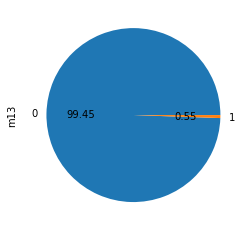

In [91]:
df['m13'].value_counts().plot.pie(autopct="%.2f")

You can see a clear ___target data imbalance___ using this visualisation. This will be critical to account for later.
### Visualisation of Continuous Variables

Lets start with plotting scatter plot for some of the columns that you want. 

#### Scatter Plots

In [92]:
px.scatter(
    df, 
    x="debt_to_income_ratio",
    y="unpaid_principal_bal",
    color='m13',
    hover_data=['interest_rate','loan_to_value']
)

There is nothing significant we can notice here , we can notice how `unpaid_principal_bal` is consistent for different `debt_to_income_ratio`'s.

In [93]:
px.scatter(
    df, 
    x="unpaid_principal_bal",
    y="borrower_credit_score",
    color="m13"
)

if you notice closely, as the `unpaid_principal_bal` is increasing the credit score is also increasing. In other words
> people with high `credit_score` have more `unpaid_principal_bal`.

which makes sense because more credit score means more trust of financial system w.r.t timely payments.

There is a lot of things that we can draw here. Please feel free to go crazy and try visualise the relationship of every column with every other columns.

### Outliers

__What are Outliers__

Outliers are data points which are different from the rest of the data. ex - if we consider a group of students, someone with a height of 7'5" would be considered as an outlier. 

__Why should we worry about them ?__ 

Outliers deviate us from the general trend of the data. They can affect some machine learning algorithms negetively. Hence, we want to handle them. 

You can see how this line is pushed away from the general trend of the data because of outliers.

[<img src="https://developer-blogs.nvidia.com/wp-content/uploads/2022/07/huber-regression.png">](http://google.com.au/)


__Dealing with Outliers__

There are different approaches you can take to dealing with outliers:
- We can choose to remove outliers in some of the columns.
- We can try and impute the outliers by capping them to upper and lower limits of a boxplot. 
- We can choose ML algorithms which are robust to outliers. 
    - Usually, gradient boosting models like `xgboost` or `lightgbm` work pretty well with all kinds of datasets and are robust to outliers. Some models like `catboost` are even robust to missing values.

#### Boxplots

A __boxplot__ can be used to detect the outliers in the data. 
It shows a box-like shape with "whiskers" coming out of either end.
We typically classify examples as outliers if they lie outside the whiskers.

You can read more about boxplots [here](https://www.simplypsychology.org/boxplots.html#:~:text=The%20interquartile%20range%20(IQR)%20is,(e.g.%20Q3%E2%88%92Q1).)

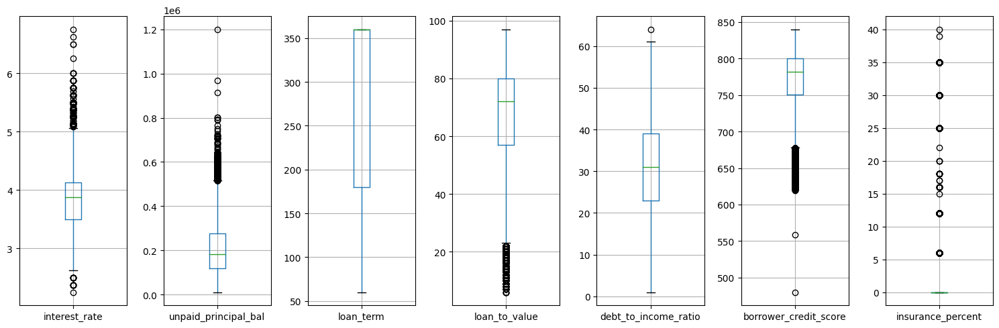

In [26]:
f,ax = plt.subplots( nrows = 1, ncols = 7 , figsize = (15,5))
axx = ax.flatten()
i = 0
for col in continuous_columns:
    df[[col]].boxplot(ax = axx[i] )
    i += 1
    
plt.tight_layout()
plt.show()
    

In the above plot, you will notice most of the columns have outliers. For now, we will use algorithms which are robust to outliers and ignore them. 

> At this point, you should have an idea on how to perform EDA by visualising your data, computing some statistics, and trying to draw interpretations from that.


# Part 3 - Feature Engineering

After having performed EDA and getting an understanding of your data, it's up to you to create features from the data based on this understanding. 
This process of creating new features is known as _feature engineering_.

Feature engineering is one of the most crucial steps in machine learning.
Creating the right features by applying __data understanding__ and __business knwoledge__ can improve the overall performance metrics by leaps and bounds. 

## Computing new features

The typical approach is to generate a huge amount of different features using a variety of strategies.
- Some of these features can be crafted by your intuition.
- Some of these features can be informed by your interpretion of your EDA.
- Some of these features can be generated by making random transformations and combinations of features which can end up being very valuable to the model. So you can choose to be creative here.

### Features that make sense intuitively

One idea is to calculate the number of months since their first payment and the start of their loan.

In [31]:
# number of days before the first payment from the originations date
df['months_until_first_payment'] = (df['first_payment_date'] - df['origination_date'])//pd.Timedelta('29 days') # this will give us the number of months, dividing by 29 to cover corner case of February

Intuitively, there's probably not much more information contained in the exact number of days given to pay back the loan than there is in the number of months. Perhaps simplifying this value will make it easier to learn some useful relationships.

Note: There is no point in keeping the both loan term in days and loan term in months as features, as they are completely dependent on one another. Here, we assume that this simplification will be helpful, and can discard the less helpful feature based on days.

In [29]:
# converting loan term into number of months, diving by 29 to cover the corner case of Feb 
df['loan_term'] =  df['loan_term'] // 29 

Another piece of business logic that makes sense if you know about loans work, is to determine whether the individual has taken insurance for the loan. In unforeseen circumstances, the insurance policy provides coverage for a certain amount of time and repays the monthly loan payments to be made by the individual.
Instead of just knowing the percentage of insurance, it would be beneficial just to know if a __person has insurance or not__.

In [30]:
#loan insurance covered Yes/No
df['has_insurance'] = df['insurance_percent'].apply( lambda x :  0 if x == 0 else 1)

Take a look at these features in your dataset now that you've created them.

In [32]:
df.head()

,source,financial_institution,interest_rate,unpaid_principal_bal,loan_term,origination_date,first_payment_date,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,loan_purpose,insurance_percent,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,m13,has_insurance,months_until_first_payment
loan_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,
268055008619,Z,"Turner, Baldwin and Rhodes",4.250,214000,12,2012-03-01,2012-05-01,95,1,22.0,694.0,C86,30.0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,2
672831657627,Y,"Swanson, Newton and Miller",4.875,144000,12,2012-01-01,2012-03-01,72,1,44.0,697.0,B12,0.0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,2
742515242108,Z,Thornton-Davis,3.250,366000,6,2012-01-01,2012-03-01,49,1,33.0,780.0,B12,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2
601385667462,X,OTHER,4.750,135000,12,2012-02-01,2012-04-01,46,2,44.0,633.0,B12,0.0,0,0,0,0,0,0,0,0,1,1,1,1,1,0,2
273870029961,X,OTHER,4.750,124000,12,2012-02-01,2012-04-01,80,1,43.0,681.0,C86,0.0,0,1,2,3,4,5,6,7,8,9,10,11,1,0,2


## Feature Selection

Now that you've created a bunch of new features, you need to determine which ones to use.
There are different approaches for different types of variables. 


The most common approaches are:
1. Correlation Coefficient: a metric used to find out the [correlation](https://en.wikipedia.org/wiki/Correlation) betwen continous variables. 
2. Chi-Squared test: test of independence for categorical columns.

### 1. Using Correlation Coefficients to Remove Highly Correlated Features
As we mentioned, we typically use this for continous variables, but sometimes interesting patterns can be seen for categorical variables as well.

So let's visualise the correlation between all the columns.

In [34]:
# correlation for continous columns

continuous_columns = [
    "interest_rate",
    "unpaid_principal_bal",
    "loan_term",
    "loan_to_value",
    "debt_to_income_ratio",
    "borrower_credit_score",
    "insurance_percent",
    "days_until_first_payment"
]

categorical_columns = [
    "source",
    "financial_institution",
    "loan_purpose",
    "has_insurance",
    "m1",
    "m2",
    "m3",
    "m4",
    "m5",
    "m6",
    "m7",
    "m8",
    "m9",
    "m10",
    "m11",
    "m12"
]

corr = df.corr()

fig = px.imshow(corr, text_auto=True, aspect="auto")
fig.show()


What we're looking for here is the more yellow cells (but not along the diagonal), which indicate a high correlation between two features.

- `interest_rate` and `loan_term` is highly correlated. The more the loan term , the more the interest rate. 
- `has_insurance` and `insurance_percent` are also very highly correlated because `has_insurance` is derived from `insurance_percent`.

We should remove either one of the columns in both the cases.


### 2. Using a Chi-Squared Test to Remove Highly Correlated Categorical Features

A [chi-squared](https://en.wikipedia.org/wiki/Chi-squared_test) test is a [statistical hypothesis](https://en.wikipedia.org/wiki/Statistical_hypothesis_testing) test primarily used to examine whether two categorical variables are independent in influencing the test statistic.

In [35]:

from scipy.stats import chi2_contingency

In [33]:
results = pd.DataFrame(columns=['col','p-value'])

for col in categorical_columns:
    _, p, _, _ = chi2_contingency( pd.crosstab(df[col], df['m13']))
    s = results.shape[0]
    results.loc[s,'col'] = col
    results.loc[s,'p-value'] = p

results

,col,p-value
0,source,0.000795
1,financial_institution,0.061209
2,loan_purpose,0.0
3,insurance_covered,0.064511
4,m1,0.0
5,m2,0.0
6,m3,0.0
7,m4,0.0
8,m5,0.0
9,m6,0.0


Typically, a p-value < 0.05 is considered significant. Hence, insignificant columns are:
1. financial_institution
2. insurance_covered

Now let's drop those categorical columns which we found to be insignificant.

In [37]:
df = df.drop(labels=['financial_institution', 'has_insurance', 'insurance_percent'], axis=1)

We will also drop the datetime columns because they dont provide any value unless we extract some information from them like `months_until_first_payment`. You can try an extract as much information from them as you want like `month_name` when loan was issued etc.
For now, we will drop these columns as well. 

In [39]:
df = df.drop(labels=["origination_date","first_payment_date"], axis=1)

# Data Preprocessing

There are a few data preprocessing techniques that need to be applied specifically if you intent to use your data for machine learning. They include:

1. Feature Encoding
2. Feature Scaling


## Feature and Label Encoding
There are generally 2 types of encoding techniques 
1. Label Encoding - used for ordinal variables
2. One-Hot Encoding : used for nominal variables


In [42]:
# dropping non significant columns from X and the target column
X = df
y = df.drop(labels=['m13'], axis= 1)


In [43]:
# apply one-hot encoding to nominal variables
X = pd.get_dummies(data=X, columns=['source', 'loan_purpose'])

## Feature Scaling

*Feature scaling* is the process of making all features on the same order of magnitude, rather than having some that are 1000x larger than others, for example.

Feature scaling is one of the most important data preprocessing step in machine learning. Algorithms that compute the distance between the features are biased significantly by numerically larger values if the data is not scaled.

Tree-based algorithms are fairly insensitive to the scale of the features. Also, feature scaling helps machine learning models trained using gradient based optimisation (including deep learning algorithms) converge and converge faster.

Normalization and standardization are the most popular scaling techniques.

### Normalisation

Normalisation, also known as min-max scaling, is calculated as:

# $X_{new} = \frac{X - X_{min}}{X_{max} - X_{min}}$

This scales the range to [0, 1]. Geometrically speaking, transformation squishes the n-dimensional data into an n-dimensional unit hypercube.
Normalization is useful when there are no outliers, as it cannot cope with them.
Usually, we would scale age and not incomes because only a few people have high incomes but the age is close to uniform

### Standardisation

Standardisation, also known as Z-Score Normalization, is the transformation of features by subtracting the mean of the data and dividing by its standard deviation.
The resulting value for each feature is often called a Z-score.

# $X_{new} = \frac{X - \mu}{\sigma}$

Standardization can be helpful in cases where the data follows a Gaussian distribution. 
However, this does not have to be necessarily true. 
Geometrically speaking, it translates the data to centre it around its original mean and squishes or expands the points around that mean so that it has a unit standard deviation in every direction.
We are just changing mean and standard deviation to those of a normal distribution, thus the shape of the original distribution is not affected.

Standardisation can handle outliers because the range of the new data is not completely determined by the max and min values.


In [44]:
X

,interest_rate,unpaid_principal_bal,loan_term,loan_to_value,number_of_borrowers,debt_to_income_ratio,borrower_credit_score,m1,m2,m3,m4,m5,m6,m7,m8,m9,m10,m11,m12,months_until_first_payment,source_X,source_Y,source_Z,loan_purpose_A23,loan_purpose_B12,loan_purpose_C86
loan_id,,,,,,,,,,,,,,,,,,,,,,,,,,
268055008619,4.250,214000,12,95,1,22.0,694.0,0,0,0,0,0,0,1,0,0,0,0,0,2,0,0,1,0,0,1
672831657627,4.875,144000,12,72,1,44.0,697.0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,1,0,0,1,0
742515242108,3.250,366000,6,49,1,33.0,780.0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,1,0,1,0
601385667462,4.750,135000,12,46,2,44.0,633.0,0,0,0,0,0,0,0,0,1,1,1,1,2,1,0,0,0,1,0
273870029961,4.750,124000,12,80,1,43.0,681.0,0,1,2,3,4,5,6,7,8,9,10,11,2,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
382119962287,4.125,153000,12,88,2,22.0,801.0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,1,0,1,0,0
582803915466,3.000,150000,4,35,1,37.0,796.0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,1,0,1,0
837922316947,3.875,166000,12,58,2,49.0,724.0,0,0,0,0,0,0,0,0,0,0,0,0,2,1,0,0,0,1,0


In [45]:
# apply normalisation using sklearn
from sklearn.preprocessing import MinMaxScaler
normalisation = MinMaxScaler()
X = normalisation.fit_transform(X)

## Key Takeaways

- Feature engineering is about coming up with new features that might contain useful information
- Feature scaling is important because some machine learning models will struggle to find the patterns in your data without it
- Normalisation and standardisation are two of the most popular approaches to feature scaling

# Part 4 - Model Training and Evaluation

Now, it's time to do some machine learning.
You have your final training and testing data, and you're ready to start training different some machine learning models to model the relationships between the features and labels.

## Train Test Split

The final thing required before training a machine learning model on our data is to split the data into different sets.
training and testing for model training and evaluation. 

You can learn more about why we perform train and test splitting [here](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html)


In [46]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y) # stratify to have same ratio in train and test split for target column

Alright, so we are getting closer to training our mdodel. This notebook was just focussed around preparing the data before we actually train the model. We did Feature Selection, Feature Encoding and then Feature Scaling. It is important to notice the flow of the preprocessing steps. It should most likely happen in this manner if not always.

### Model Training 

We will be training different models and see which works best. 
1. Logistic Regression : For this model, how to prepare the data w.r.t outliers, feature scaling and feature encoding ? 
2. Decision Tree : How to prepare the data for this model ? Is it robust to outliers ? 
3. Random Forest : [Read More Here](https://towardsdatascience.com/understanding-random-forest-58381e0602d2)
4. SVM : [Read More Here](https://towardsdatascience.com/https-medium-com-pupalerushikesh-svm-f4b42800e989#:~:text=SVM%20or%20Support%20Vector%20Machine,separates%20the%20data%20into%20classes.)
5. Boosting Models: GradientBoostingClassifier(), ExtraTreesClassifier()

In [47]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier, ExtraTreesClassifier
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score

In [48]:
# Train Logistic Model
model = LogisticRegression()
model.fit(X_train, y_train)

LogisticRegression()

### Model Evaluation

These metrics help us understand which model works better over others. You can learn more about the metrics here: [Link](https://neptune.ai/blog/performance-metrics-in-machine-learning-complete-guide#:~:text=They're%20used%20to%20train,t%20need%20to%20be%20differentiable.)
1. Accuracy : Is Accuracy as a metric relavant here ?
2. Precision : [Read More](https://developers.google.com/machine-learning/crash-course/classification/precision-and-recall)
3. Recall : [Read More](https://developers.google.com/machine-learning/crash-course/classification/precision-and-recall)
4. Confusion Matrix

In [49]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, plot_confusion_matrix, precision_score, recall_score
pred = model.predict(X_test)
print (f"The accuracy is {accuracy_score(y_test, pred)}")

The accuracy is 0.9952897926359929


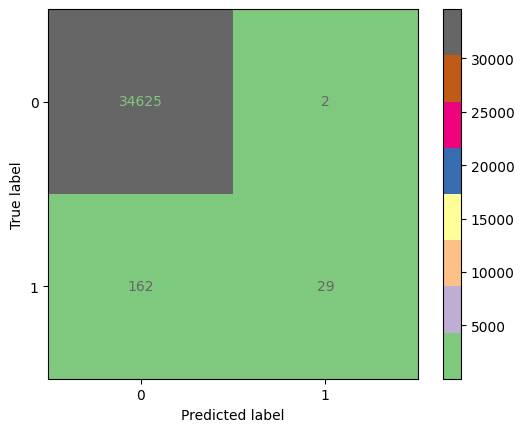

In [53]:
plot_confusion_matrix(model,X_test, y_test, cmap='Accent')

In [54]:
print("Classification report:")
print(classification_report(pred, y_test))

Classification report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     34787
           1       0.15      0.94      0.26        31

    accuracy                           1.00     34818
   macro avg       0.58      0.97      0.63     34818
weighted avg       1.00      1.00      1.00     34818



Implement a __evaluation()__ function to evaluate the metrics mentioned above 

In [55]:
def evaluate(model, verbose=False):
    """
    Set verbose = True to print accuracy, classification report and plot
    confusion matrix
    """
    metrics = {}
    pred = model.predict(X_test)
    metrics['accuracy'] = accuracy_score(y_test, pred)
    verbose and print (f"The accuracy is {metrics['accuracy']}")
    verbose and plot_confusion_matrix(model,X_test, y_test)
    metrics['precision'] = precision_score(y_test, pred)
    metrics['recall'] = recall_score(y_test, pred)
    verbose and print (f"The classification report looks like : \n {classification_report(pred, y_test)}")
    return metrics
    

The accuracy is 0.9957493250617496
The classification report looks like : 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     34725
           1       0.36      0.73      0.48        93

    accuracy                           1.00     34818
   macro avg       0.68      0.86      0.74     34818
weighted avg       1.00      1.00      1.00     34818



{'accuracy': 0.9957493250617496,
 'precision': 0.7311827956989247,
 'recall': 0.35602094240837695}

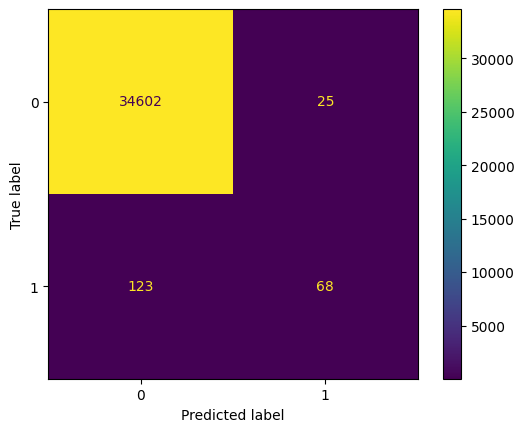

In [56]:
from sklearn.ensemble import RandomForestClassifier
random_forest = RandomForestClassifier()
random_forest.fit(X_train, y_train)
evaluate(random_forest, verbose = True)


In [57]:
output = pd.DataFrame(columns=['model', 'accuracy', 'precision', 'recall'])

def train_model(model):
    global output
    model.fit( X_train, y_train) #X_train and y_train are used globally
    metrics = evaluate(model)
    metrics["model"] = f"{model}"
    output = output.append(metrics, ignore_index=True)
    

In [58]:
for model in [RandomForestClassifier(), GradientBoostingClassifier(), ExtraTreesClassifier(), KNeighborsClassifier()]:
    print (f"Training model: {model}" )
    train_model(model)
    

Training model: RandomForestClassifier()
Training model: GradientBoostingClassifier()
Training model: ExtraTreesClassifier()
Training model: KNeighborsClassifier()


In [59]:
output

,model,accuracy,precision,recall
0,RandomForestClassifier(),0.995807,0.741935,0.361257
1,GradientBoostingClassifier(),0.995778,0.729167,0.366492
2,ExtraTreesClassifier(),0.995749,0.721649,0.366492
3,KNeighborsClassifier(),0.994802,0.750000,0.078534


If we consider __Recall__ `GradientBoostinClassifier` is working better than other models in default configuration. Lets improve the function to automatically determine the best model

In [60]:
output = pd.DataFrame(columns=['model','accuracy','precision','recall'])

def train_model(model):
    global output
    model.fit( X_train, y_train) #X_train and y_train are used globally
    metrics = evaluate(model)
    metrics["model"] = f"{model}"
    output = output.append(metrics, ignore_index=True)

def select_best(model_list):
    for model in model_list:
        print ("Training Model: ", model)
        train_model(model)
    output.recall = output.recall.astype('float64')
    print (f"The best model is \n { output.loc[[output.recall.argmax()]]}")

In [61]:
select_best([
    RandomForestClassifier(),
    GradientBoostingClassifier(), 
    ExtraTreesClassifier(), 
    KNeighborsClassifier(),
    LogisticRegression(),
    SVC() 
])

Training Model:  RandomForestClassifier()
Training Model:  GradientBoostingClassifier()
Training Model:  ExtraTreesClassifier()
Training Model:  KNeighborsClassifier()
Training Model:  LogisticRegression()
Training Model:  SVC()
The best model is 
                     model  accuracy  precision    recall
2  ExtraTreesClassifier()  0.995749   0.704762  0.387435


In [62]:
output

,model,accuracy,precision,recall
0,RandomForestClassifier(),0.995864,0.752688,0.366492
1,GradientBoostingClassifier(),0.995778,0.729167,0.366492
2,ExtraTreesClassifier(),0.995749,0.704762,0.387435
3,KNeighborsClassifier(),0.994802,0.750000,0.078534
4,LogisticRegression(),0.995290,0.935484,0.151832
5,SVC(),0.994974,0.944444,0.089005


In [63]:
model = ExtraTreesClassifier()
model.fit(X_train, y_train)

ExtraTreesClassifier()

### Saving the Model

So you're happy with your model? Now you need to save it.

Once it's saved, we can share it with our team, load it back in to make predictions in some other system, or load it back in to compare with new models that you train, for example.

In [119]:
import joblib 
filename = 'finalized_model.pkl'
joblib.dump(model, filename)


['finalized_model.sav']

## Key Takeaways
- The process for model training and evaluation goes as follows
    - Train a model on the training set
    - Evaluate the model on the validation set
    - Repeat for as many variations of model as you can
    - Select the best model based on its performance on the validation set
    - Report the performance of the model using the test set, but do not use this to make any decisions about the model!
- Never use the test set to choose between models. The moment you pick a model based on test set performance, you're showing it the answers!
- Both the validatoin and test set are a measure of how well the model will generalise to unseen examples
- The validation set is used to compare different models and choose between them once they've been trained
- The difference 
- This demo barely scratches the surface. Going forward, you could explore:
    - the settings of the different models we've experimented with, which are known as hyperparameters
    - other machine learning models, such as deep learning models like neural networks
    - other machine learning libraries, like Apache Spark's MLLib
    - other preprocessing techniques
